#**Environment**

In [ ]:
# !pip install ydata_profiling

In [1]:
# Google Colab or Locally
try:
    from google.colab import drive
    drive.mount('/content/drive')
    DATA_PATH = "/content/drive/MyDrive/MLOps/MLOps_Project"
    print("Running in Google Colab... Drive mounted.")
except ModuleNotFoundError:
    DATA_PATH = "./"
    print("Running Locally... using local data path.")

Mounted at /content/drive
Running in Google Colab... Drive mounted.


In [37]:
# Libraries
import pandas as pd
import numpy as np
import os
import warnings
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import FunctionTransformer
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Optional Import Ydata Profiling
try:
    from ydata_profiling import ProfileReport
    HAS_PROFILING = True
except Exception:
    HAS_PROFILING = False
    print("ydata_profiling not available (optional).\nTo install: pip install ydata-profiling")

In [22]:
# Warnings
warnings.filterwarnings("ignore")

#**Absenteeism at Work**

##**Dataset**

In [3]:
df = pd.read_csv(os.path.join(os.path.abspath(DATA_PATH), "work_absenteeism.csv"))

##**EDA**

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 754 entries, 0 to 753
Data columns (total 20 columns):
 #   Column                           Non-Null Count  Dtype
---  ------                           --------------  -----
 0   Reason for absence               754 non-null    int64
 1   Month of absence                 754 non-null    int64
 2   Day of the week                  754 non-null    int64
 3   Seasons                          754 non-null    int64
 4   Transportation expense           754 non-null    int64
 5   Distance from Residence to Work  754 non-null    int64
 6   Service time                     754 non-null    int64
 7   Age                              754 non-null    int64
 8   Work load Average/day            754 non-null    int64
 9   Hit target                       754 non-null    int64
 10  Disciplinary failure             754 non-null    int64
 11  Education                        754 non-null    int64
 12  Son                              754 non-null    i

In [5]:
df.head(3)

,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,Hit target,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,26,7,3,1,289,36,13,33,240,97,0,1,2,1,0,1,90,172,30,4
1,0,7,3,1,118,13,18,50,240,97,1,1,1,1,0,0,98,176,31,0
2,23,7,4,1,179,51,18,38,240,97,0,1,0,1,0,0,89,170,31,2


In [6]:
baseline_info = {
    "shape": df.shape,
    "dtypes": df.dtypes.value_counts().to_dict(),
    "nulls": df.isna().sum().sum()
}
baseline_info

{'shape': (754, 20), 'dtypes': {dtype('int64'): 20}, 'nulls': np.int64(0)}

In [7]:
profile = ProfileReport(df, title='Summary Report')
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 20/20 [00:00<00:00, 67.15it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####**Encoding Dictonaries**

In [8]:
reason_absence = {
    0: 'Unknown',
    1: 'Certain infectious and parasitic diseases',
    2: 'Neoplasms',
    3: 'Diseases of the blood and blood-forming organs and certain disorders involving the immune mechanism',
    4: 'Endocrine, nutritional and metabolic diseases',
    5: 'Mental and behavioural disorders',
    6: 'Diseases of the nervous system',
    7: 'Diseases of the eye and adnexa',
    8: 'Diseases of the ear and mastoid process',
    9: 'Diseases of the circulatory system',
    10: 'Diseases of the respiratory system',
    11: 'Diseases of the digestive system',
    12: 'Diseases of the skin and subcutaneous tissue',
    13: 'Diseases of the musculoskeletal system and connective tissue',
    14: 'Diseases of the genitourinary system',
    15: 'Pregnancy, childbirth and the puerperium',
    16: 'Certain conditions originating in the perinatal period',
    17: 'Congenital malformations, deformations and chromosomal abnormalities',
    18: 'Symptoms, signs and abnormal clinical and laboratory findings, not elsewhere classified',
    19: 'Injury, poisoning and certain other consequences of external causes',
    20: 'External causes of morbidity and mortality',
    21: 'Factors influencing health status and contact with health services',
    22: 'Patient follow-up',
    23: 'Medical consultation',
    24: 'Blood donation',
    25: 'Laboratory examination',
    26: 'Unjustified absence',
    27: 'Physiotherapy',
    28: 'Dental consultation'
}

months = {
    0: 'Unknown',
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',
    5: 'May',
    6: 'June',
    7: 'July',
    8: 'August',
    9: 'September',
    10: 'October',
    11: 'November',
    12: 'December'
}

days = {
    2: 'Monday',
    3: 'Tuesday',
    4: 'Wednesday',
    5: 'Thursday',
    6: 'Friday'
}

seasons = {
    1: 'Winter',
    2: 'Spring',
    3: 'Summer',
    4: 'Fall'
}

education = {
    1: 'High School',
    2: 'Graduate',
    3: 'Postgraduate',
    4: 'Master and Doctor'
}

yes_no = {
    0: 'No',
    1: 'Yes'
}

In [9]:
def body_mass_category(bmi):
    if bmi < 18.5:
        return 'Underweight'
    elif bmi < 25:
        return 'Normal'
    elif bmi < 30:
        return 'Overweight'
    else:
        return 'Obese'

In [10]:
df_copy = df.copy()
#df_copy['Reason for absence'] = df_copy['Reason for absence'].map(reason_absence)
df_copy['Month of absence'] = df_copy['Month of absence'].map(months)
df_copy['Day of the week'] = df_copy['Day of the week'].map(days)
df_copy['Seasons'] = df_copy['Seasons'].map(seasons)
df_copy['Disciplinary failure'] = df_copy['Disciplinary failure'].map(yes_no)
df_copy['Education'] = df_copy['Education'].map(education)
df_copy['Social drinker'] = df_copy['Social drinker'].map(yes_no)
df_copy['Social smoker'] = df_copy['Social smoker'].map(yes_no)
df_copy['Body mass index'] = df_copy['Body mass index'].apply(body_mass_category)

In [30]:
categorical_cols = ['Reason for absence', 'Month of absence','Day of the week', 'Seasons',
                    'Disciplinary failure', 'Education', 'Son', 'Social drinker', 'Social smoker',
                    'Pet', 'Weight', 'Height', 'Body mass index']

###**Visualizations**

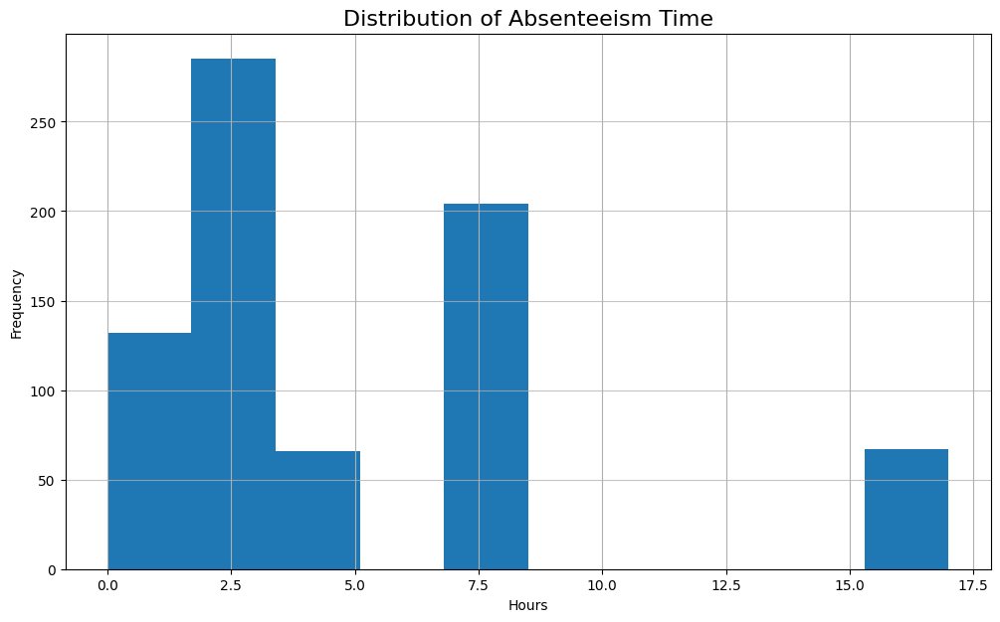

In [13]:
plt.figure(figsize=(12, 7))
df_copy['Absenteeism time in hours'].hist()
plt.title("Distribution of Absenteeism Time", fontsize=16)
plt.xlabel("Hours")
plt.ylabel("Frequency")
plt.grid(axis='y', alpha=0.75)
plt.show()

In [17]:
corr = df.corr()
target_corr = corr['Absenteeism time in hours'].sort_values(ascending=False)

print("Correlation with 'Absenteeism time in hours':\n")
print(target_corr)

Correlation with 'Absenteeism time in hours':

Absenteeism time in hours          1.000000
Son                                0.122274
Transportation expense             0.121371
Social drinker                     0.116966
Work load Average/day              0.103350
Height                             0.069410
Weight                             0.029372
Month of absence                   0.014303
Social smoker                      0.010496
Hit target                         0.010469
Distance from Residence to Work   -0.010582
Seasons                           -0.016535
Education                         -0.018163
Age                               -0.021168
Service time                      -0.023421
Pet                               -0.029167
Body mass index                   -0.056909
Day of the week                   -0.114271
Reason for absence                -0.167076
Disciplinary failure              -0.262925
Name: Absenteeism time in hours, dtype: float64


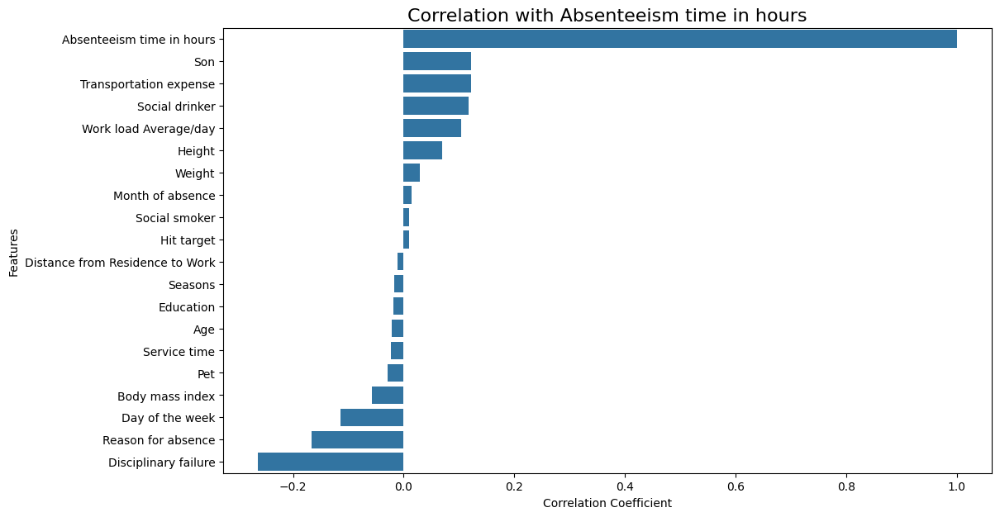

In [18]:
plt.figure(figsize=(12, 7))
sns.barplot(x=target_corr.values, y=target_corr.index)
plt.title("Correlation with Absenteeism time in hours", fontsize=16)
plt.xlabel("Correlation Coefficient")
plt.ylabel("Features")
plt.show()

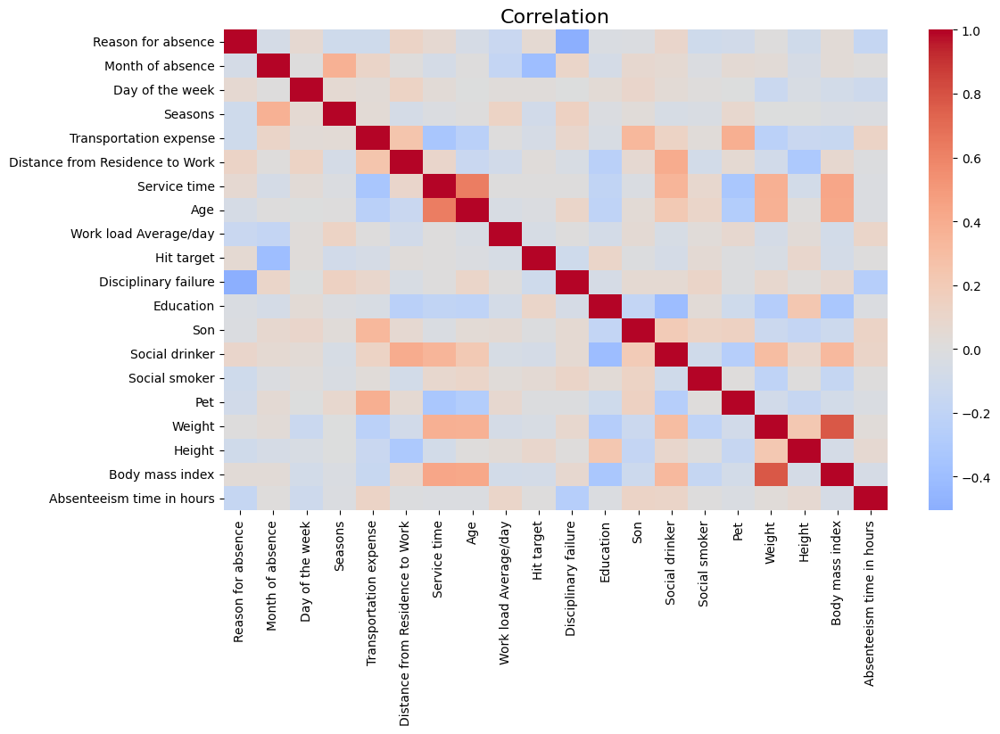

In [19]:
plt.figure(figsize=(12, 7))
sns.heatmap(corr, annot=False, cmap="coolwarm", center=0)
plt.title("Correlation", fontsize=16)
plt.show()

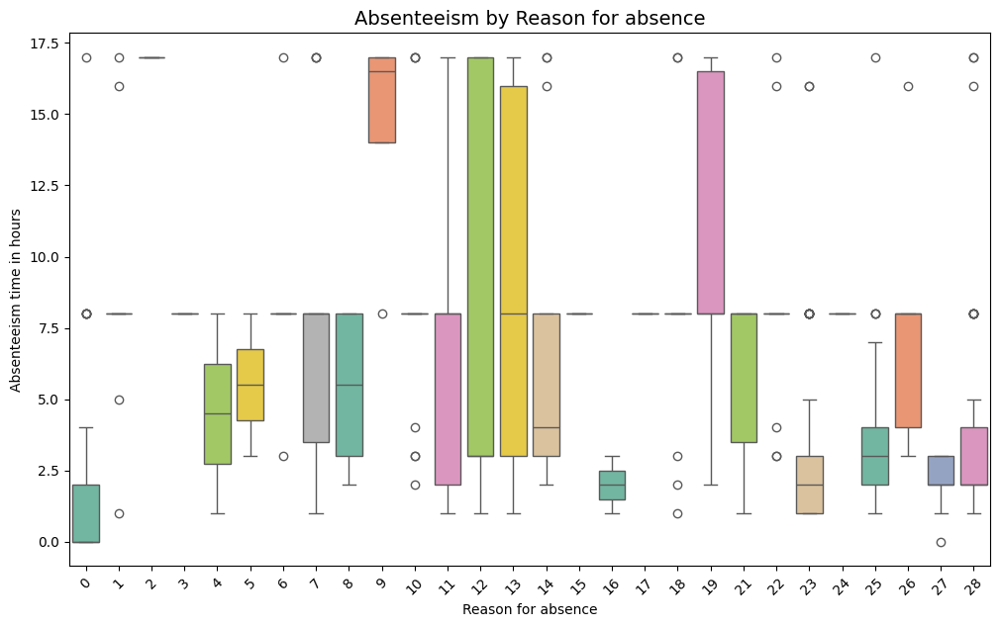

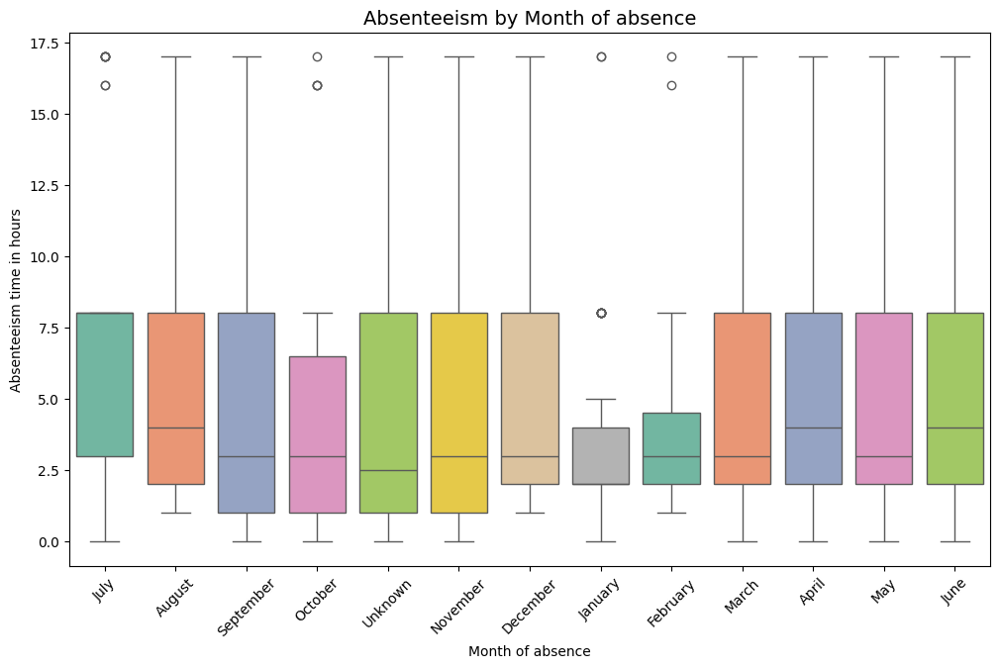

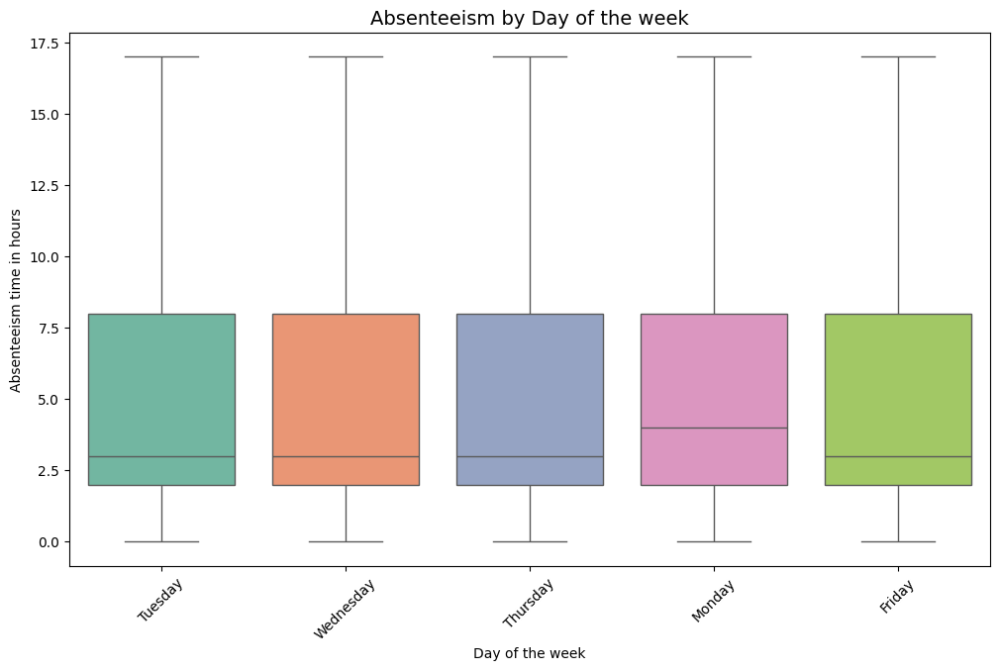

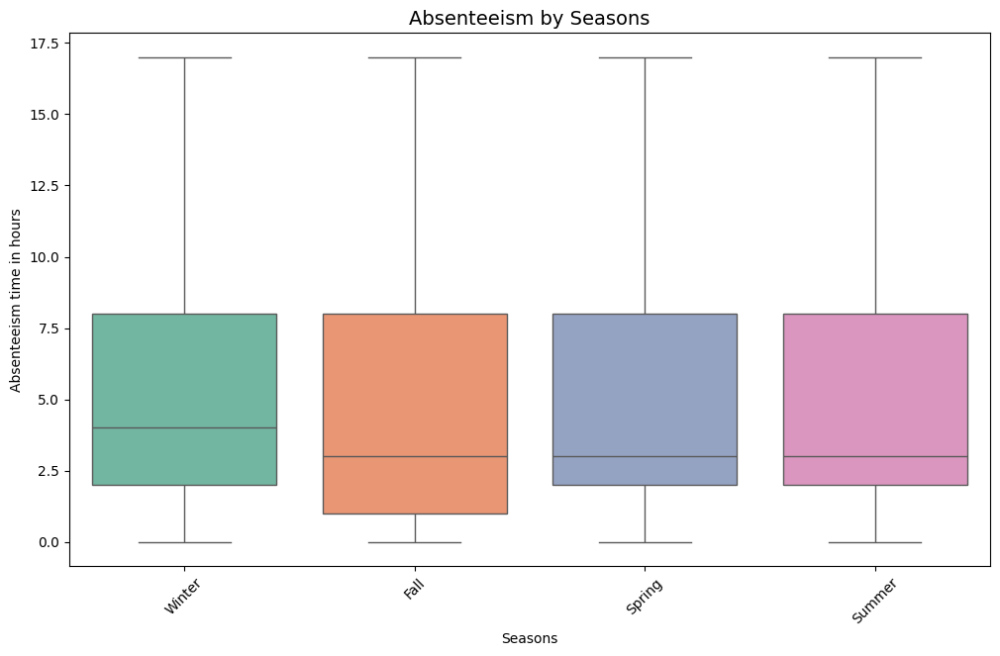

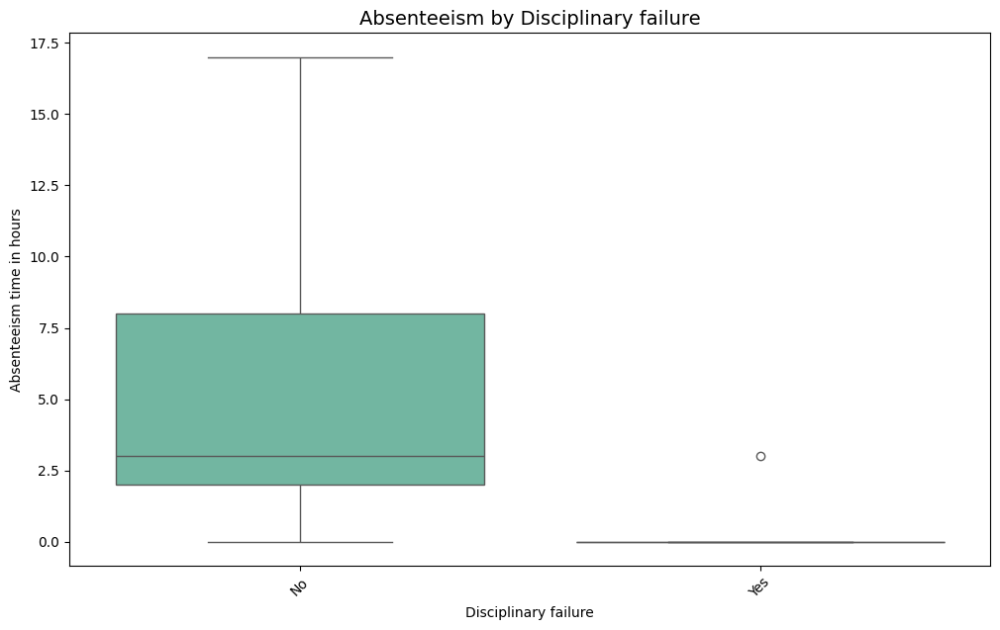

...

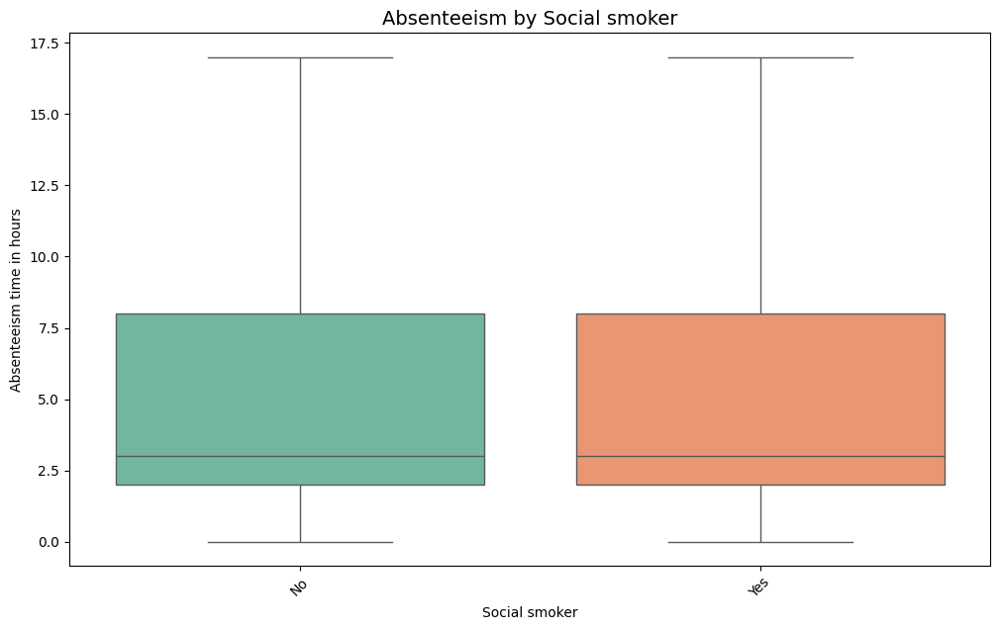

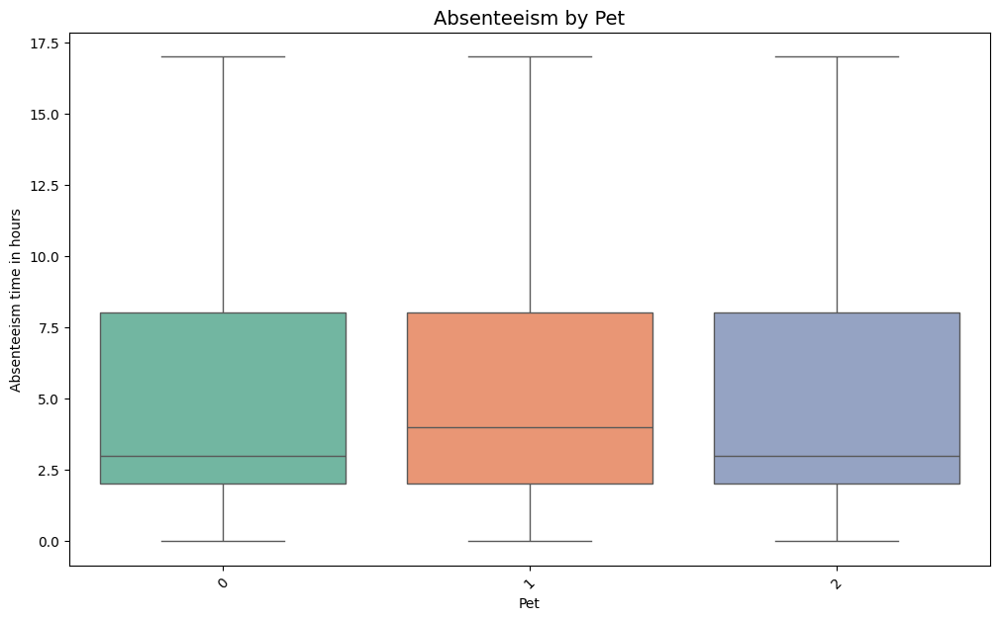

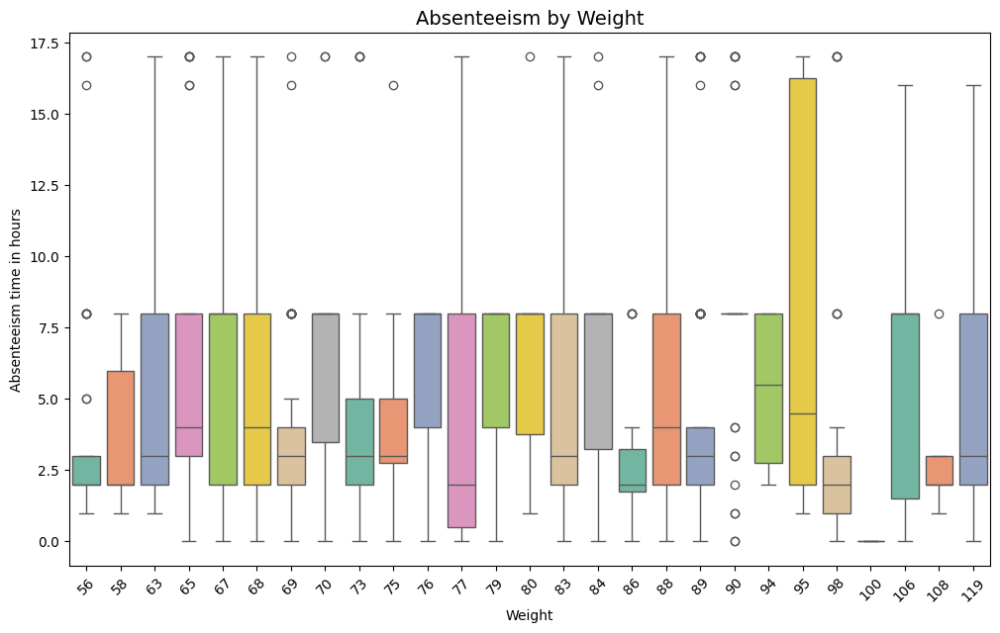

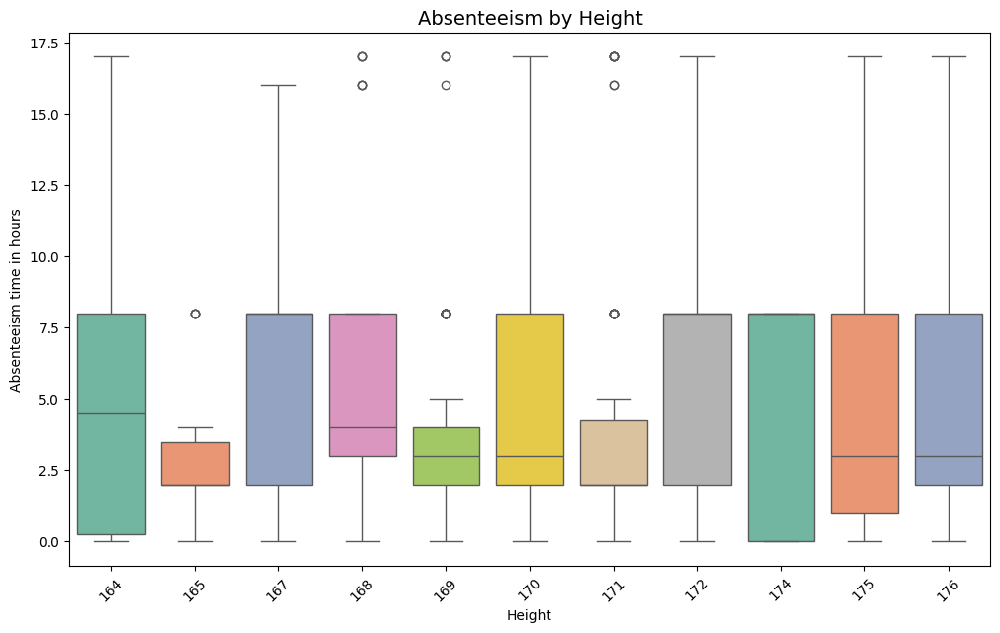

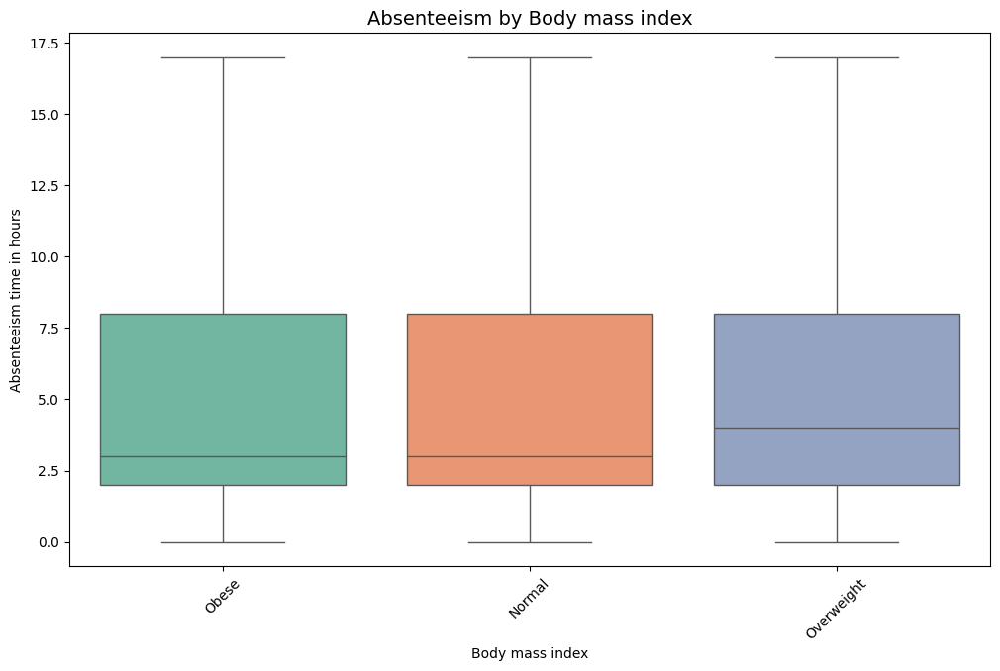

In [27]:
for col in categorical_cols:
    plt.figure(figsize=(12, 7))
    sns.boxplot(x=col, y='Absenteeism time in hours', data=df_copy, palette="Set2", hue=col, legend=False)
    plt.title(f"Absenteeism by {col}", fontsize=14)
    plt.xticks(rotation=45)
    plt.show()

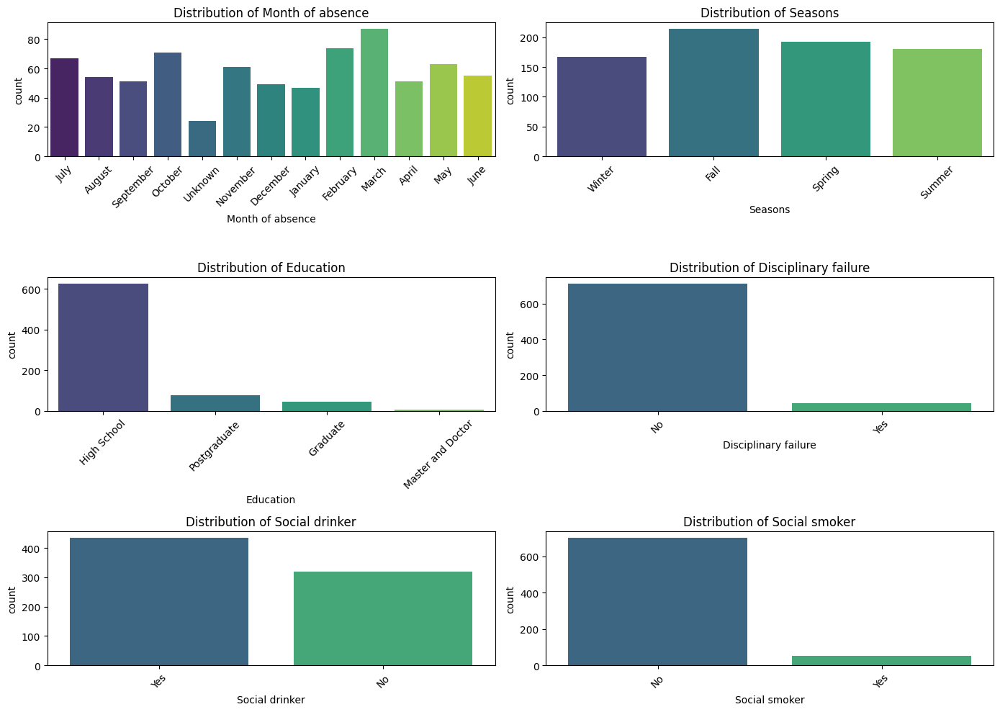

In [34]:
categorical_cols = ['Month of absence', 'Seasons', 'Education',
                    'Disciplinary failure', 'Social drinker', 'Social smoker']

plt.figure(figsize=(14, 10))
for i, col in enumerate(categorical_cols, 1):
    plt.subplot(3, 2, i)
    sns.countplot(x=col, data=df_copy, palette='viridis')
    plt.title(f'Distribution of {col}')
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

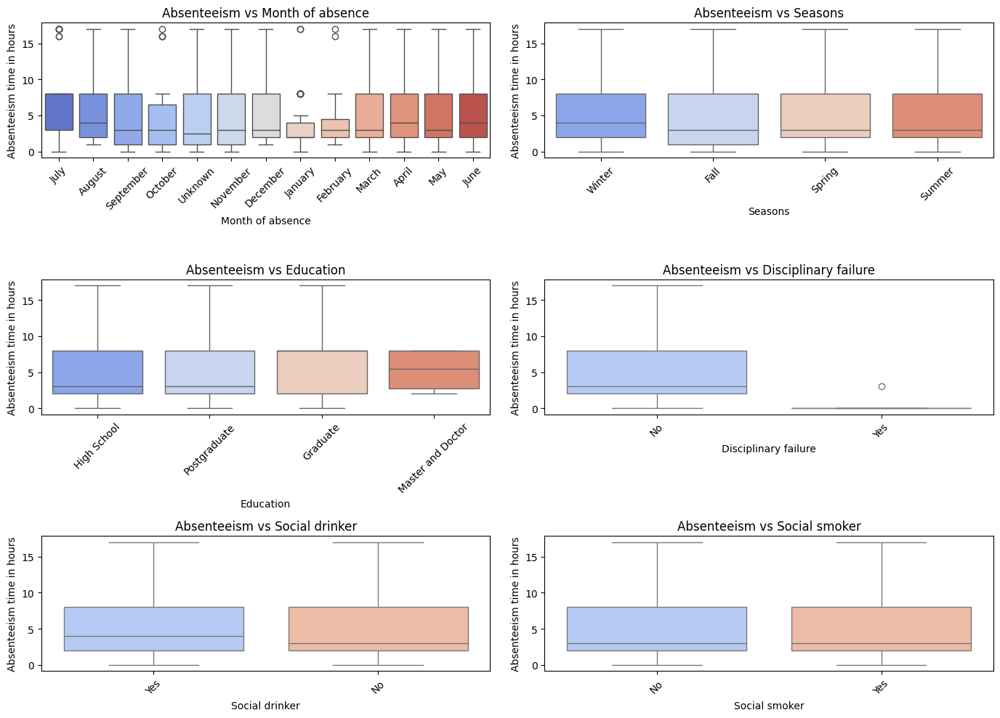

In [35]:
plt.figure(figsize=(14, 10))
for i, col in enumerate(categorical_cols, 1):
    plt.subplot(3, 2, i)
    sns.boxplot(x=col, y='Absenteeism time in hours', data=df_copy, palette='coolwarm')
    plt.title(f'Absenteeism vs {col}')
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

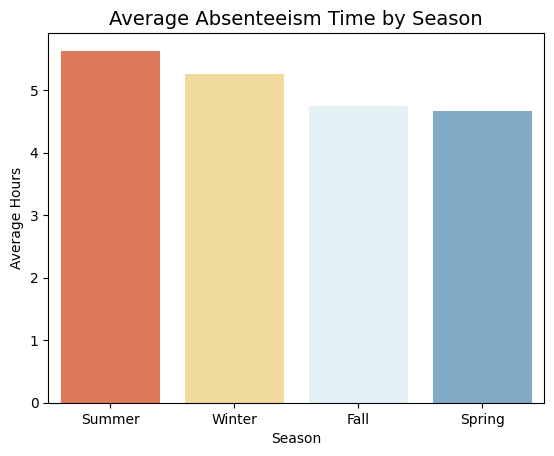

In [36]:
avg_absence = df_copy.groupby('Seasons')['Absenteeism time in hours'].mean().sort_values(ascending=False)
sns.barplot(x=avg_absence.index, y=avg_absence.values, palette='RdYlBu')
plt.title('Average Absenteeism Time by Season', fontsize=14)
plt.ylabel('Average Hours')
plt.xlabel('Season')
plt.show()

##**Feature Engineering**

In [39]:
# --- Normalization (scaling of continuous variables).
scaler = StandardScaler()
numeric_cols = ['Transportation expense', 'Distance from Residence to Work',
                'Service time', 'Age', 'Work load Average/day', 'Weight',
                'Height', 'Body mass index']

df_scaled = df.copy()
df_scaled[numeric_cols] = scaler.fit_transform(df_scaled[numeric_cols])

# --- Encoding of categorical variables.
df_encoded = pd.get_dummies(df_copy,
                            columns=['Month of absence', 'Seasons', 'Education',
                                     'Disciplinary failure', 'Social drinker', 'Social smoker'],
                            drop_first=True)

# --- PCA (dimensionality reduction for numerical variables).
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df_scaled[numeric_cols])

print("Variance explained by the first 2 PCA components:",
      round(sum(pca.explained_variance_ratio_) * 100, 2), "%")

Variance explained by the first 2 PCA components: 51.88 %
